In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error
from tensorflow import keras
from tensorflow.keras import layers
import ast  # Library for handling literal_eval
from geopy.distance import geodesic


df = pd.read_csv('merged.csv')
# columns = ['maincategory', 'longitude', 'latitude', 'starttime', 'duration', 'subCategoryA', 'attendinggroups', 'closuretype', 'mainstreet']
# df = df[columns]
# df = df[df['maincategory']=='Crash']
df=df.dropna()
# Print the column names to verify
print(df.columns)

quantile_001 = df['duration'].quantile(0.01)
quantile_099 = df['duration'].quantile(0.99)
df = df[(df['duration'] >= quantile_001) & (df['duration'] <= quantile_099)]

Unique values for Main_Category: [1 0 2]
Unique values for Primary_Vehicle: [1 5 3 0 6 2 4]
Unique values for Secondary_Vehicle: [2 9 4 8 6 3 0 7 1 5]
Unique values for Is_Major_Incident: [0 1]
Unique values for Closure_Type: [0 2 1 4 3]
Unique values for Direction: [3 8 7 5 1 2 0 6 9 4]
Unique values for Traffic_Volume: [3 2 0 1]
Unique values for Day: [5 6 4 0 2 3 1]
Unique values for Num_Vehicles_Involved: [2 1 3 4 5 6 7 8 9]
Unique values for Month: [ 8  9 10 11 12  1  2  3  4  5  6  7]
Unique values for Hour: [19  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 22 23 16 18 21 20]
Translation table for 'Main_Category':
 {1: 0, 0: 1, 2: 2}
   Main_Category  Longitude  Latitude  Day   duration  Primary_Vehicle   
0              1    151.058  -33.9431    5  39.319950                1  \
1              0    151.159  -33.8096    6  12.029000                1   
2              1    150.875  -33.7344    6  16.956667                1   
3              1    150.973  -33.8172    6  42.8041

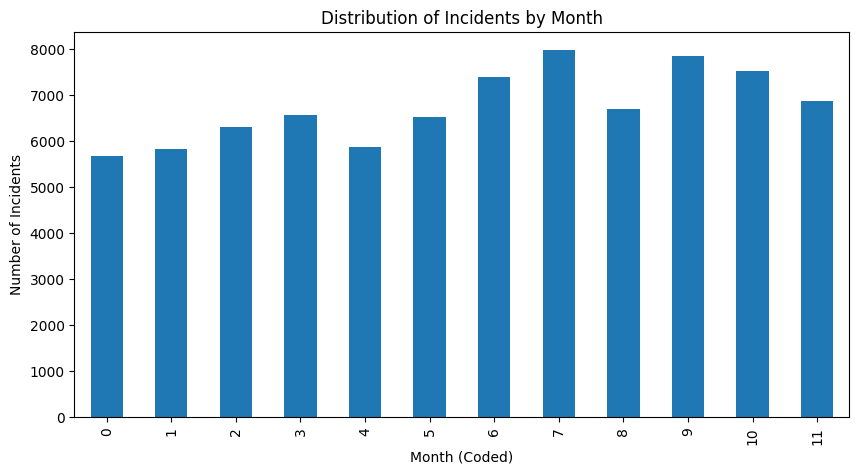

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the DataFrame
# Assuming your CSV file is named 'data.csv' and it's in the same directory as your script
# df = pd.read_csv('data.csv')
# print(df.head())

# Step 2: Identify Categorical Variables
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle',
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Day', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Print unique values for each categorical variable
for var in categorical_vars:
    print(f"Unique values for {var}: {df[var].unique()}")

# Step 3: Create Translation Tables for Categorical Variables
translation_tables = {}
for var in categorical_vars:
    translation_tables[var] = {k: v for v, k in enumerate(df[var].dropna().unique())}

# Optionally print a translation table for "Main_Category" to check
print("Translation table for 'Main_Category':\n", translation_tables['Main_Category'])

# Step 4: Transform Data Using the Translation Tables
for var in categorical_vars:
    # We use the 'get' method to handle any items that might not be present in the translation table (e.g., due to NaN entries).
    df[var + '_coded'] = df[var].map(lambda x: translation_tables[var].get(x, np.nan))

# Show the transformed data
print(df.head())

# Success message
print("Data transformation complete. DataFrame is ready for further analysis.")

# Additional example: Plotting a basic bar chart using the transformed data if appropriate
if 'Month_coded' in df.columns:
    plt.figure(figsize=(10, 5))
    df['Month_coded'].value_counts().sort_index().plot(kind='bar')
    plt.title('Distribution of Incidents by Month')
    plt.xlabel('Month (Coded)')
    plt.ylabel('Number of Incidents')
    plt.show()

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame
# replace 'path_to_file.csv' with the actual path to your data file.
# df = pd.read_csv('path_to_file.csv')

# List of categorical variables based on the provided metadata
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Day', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Plotting distribution for each categorical variable
for var in categorical_vars:
    plt.figure(figsize=(12, 6))
    if df[var].nunique() <= 10:  # Filtering to ensure not too many unique categories
        # Boxplot of 'duration' across the categories of variable 'var'
        sns.boxplot(x=var, y='duration', data=df)
        plt.title(f'Boxplot of Duration by {var}')
        plt.xticks(rotation=45)  # Rotate the x labels for better readability
        plt.show()

        # Density plot using seaborn
        plt.figure(figsize=(12, 6))
        sns.histplot(data=df, x='duration', hue=var, element='step', stat='density', common_norm=False)
        plt.title(f'Density Plot of Duration by {var}')
        plt.xlabel('Duration')
        plt.ylabel('Density')
        plt.legend(title=var, frameon=False)
        plt.show()
    else:
        print(f"Variable {var} has too many categories to display effectively in a single plot.")

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your DataFrame here
# Example: df = pd.read_csv('path_to_your_data.csv')

# Note: Replace 'path_to_your_data.csv' with the actual path to your dataset.

# List of categorical variables based on the provided metadata
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Day', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Assuming 'duration' is the continuous variable we are studying
# Plot boxplots and density plots for each categorical variable
for var in categorical_vars:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=var, y='duration', data=df)
    plt.title(f'Boxplot - Distribution of Duration by {var}')
    plt.xticks(rotation=45)  # Rotate labels for better readability
    plt.show()

    # Density plot using seaborn
    plt.figure(figsize=(12, 6))
    # Handle cases where the number of unique values is high, which might clutter the plot
    if df[var].nunique() <= 10:
        sns.histplot(data=df, x='duration', hue=var, element='step', stat='density', common_norm=False, palette='viridis')
        plt.title(f'Density Plot of Duration by {var}')
        plt.xlabel('Duration')
        plt.ylabel('Density')
    else:
        print(f"Skipped density plot for {var} due to high number of unique categories.")
    plt.show()

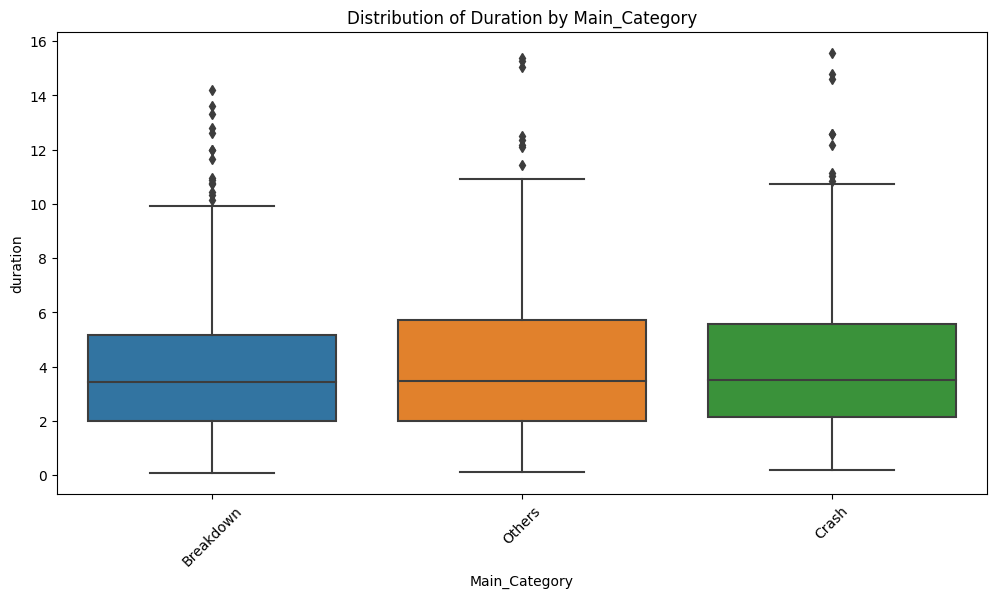

Kruskal-Wallis Test for Main_Category - p-value: 0.7501643885513516


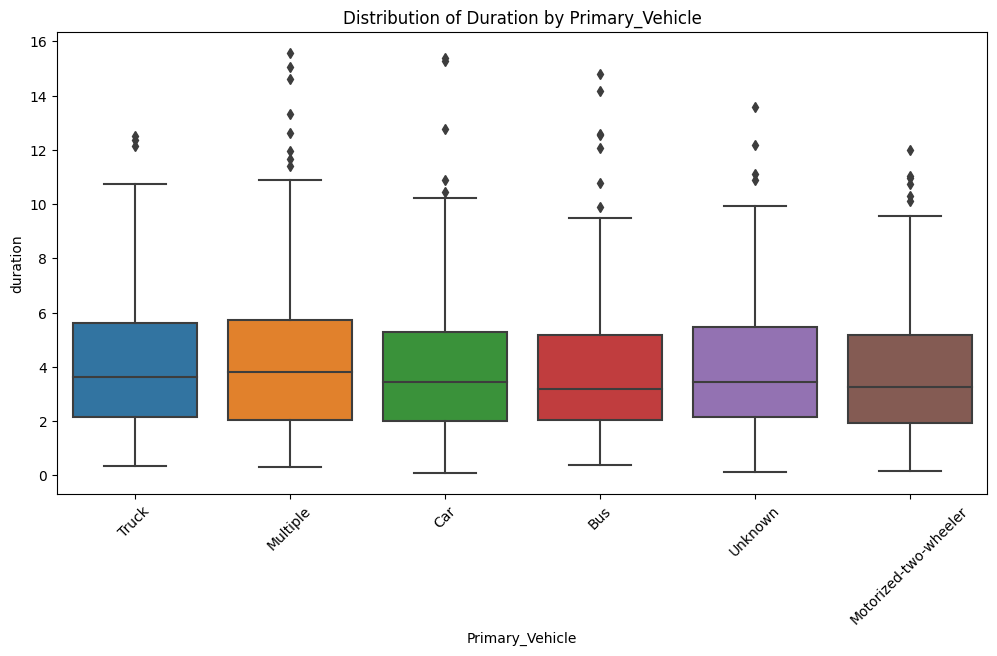

Kruskal-Wallis Test for Primary_Vehicle - p-value: 0.5549525704598228


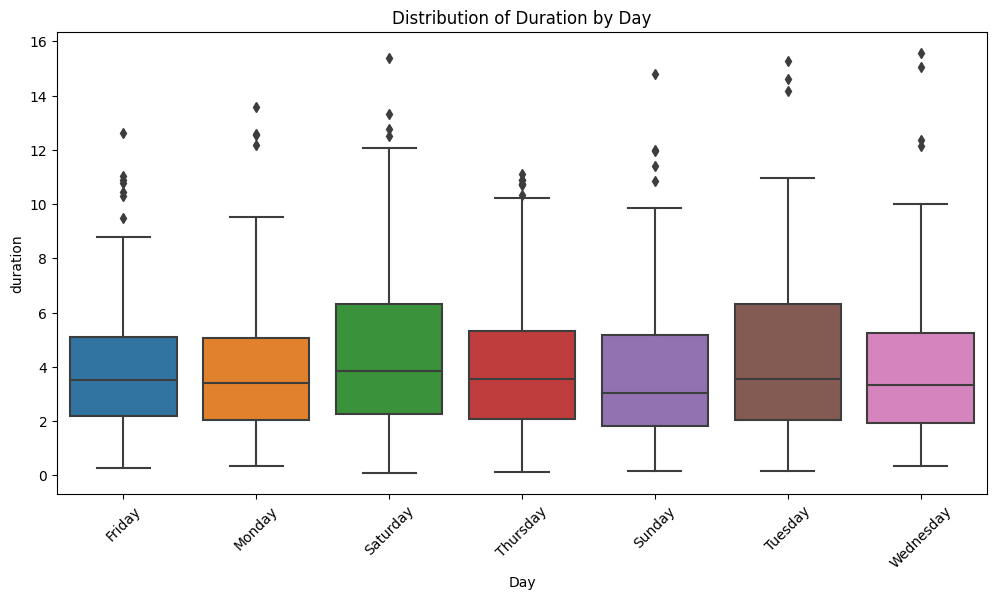

Kruskal-Wallis Test for Day - p-value: 0.43364903131133004


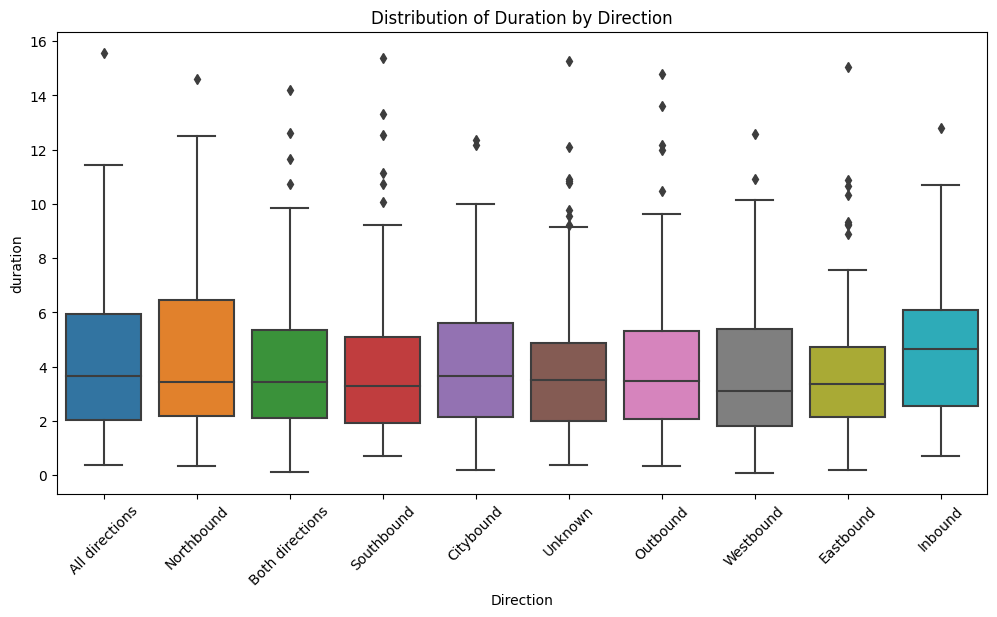

Kruskal-Wallis Test for Direction - p-value: 0.5406607049211754


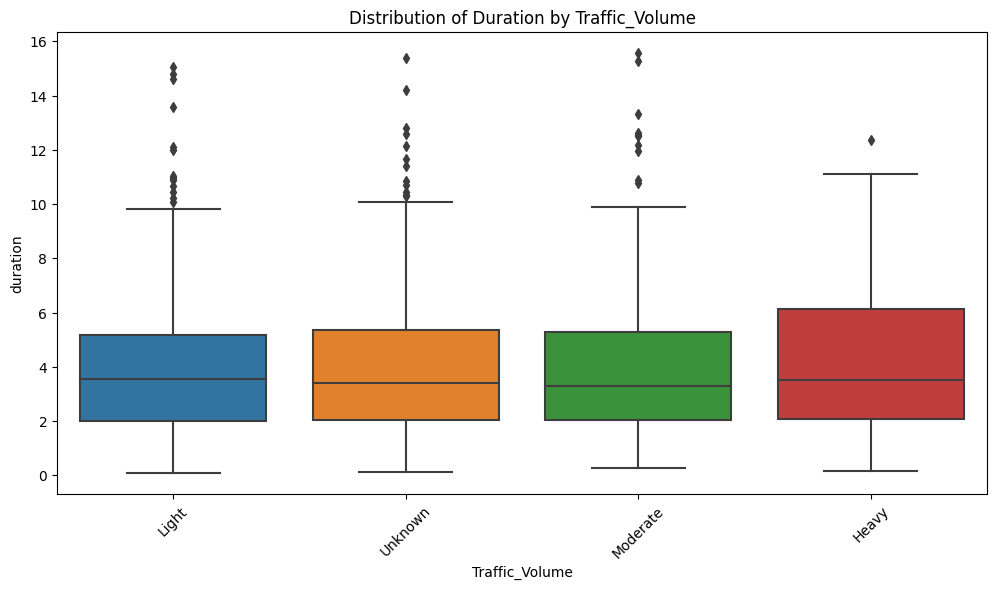

Kruskal-Wallis Test for Traffic_Volume - p-value: 0.6705451363024504


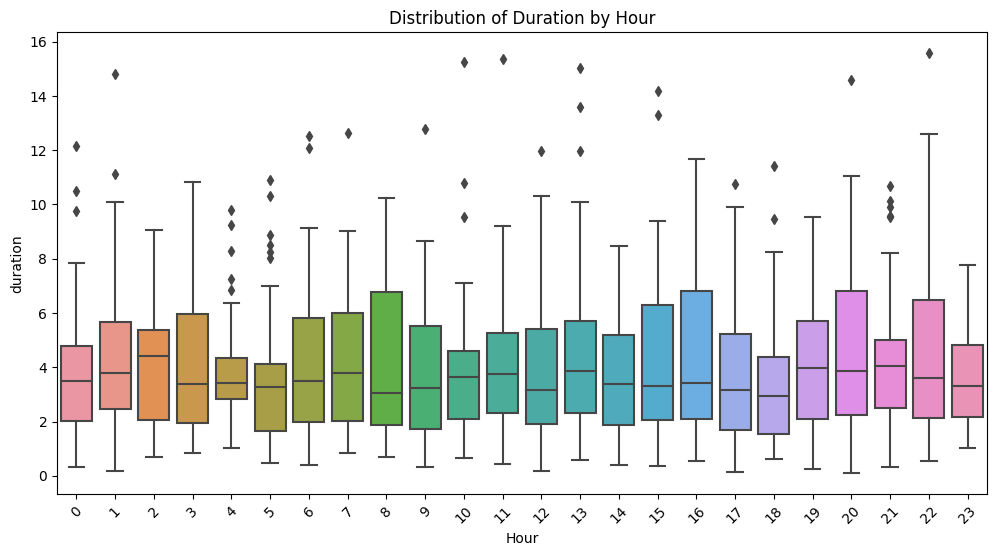

Kruskal-Wallis Test for Hour - p-value: 0.987599861234487


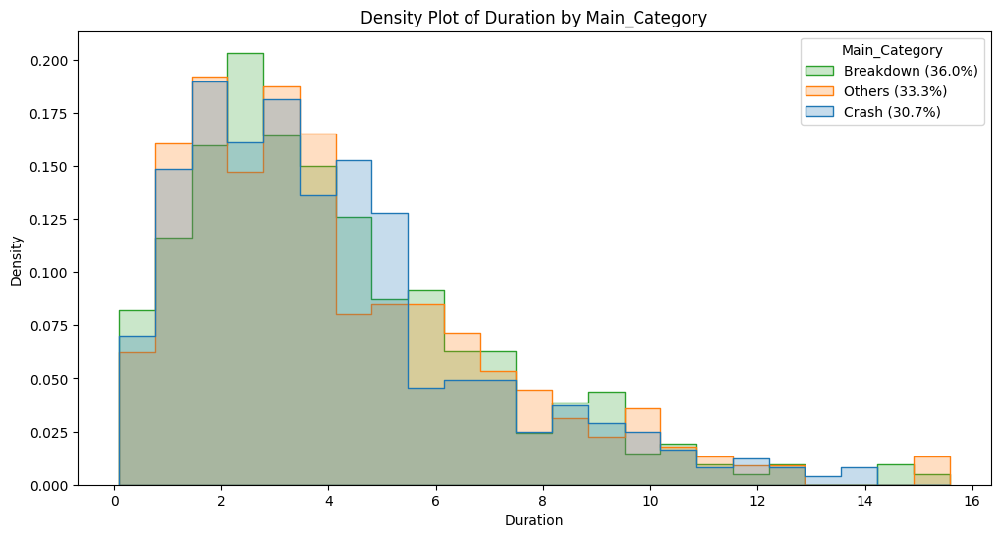

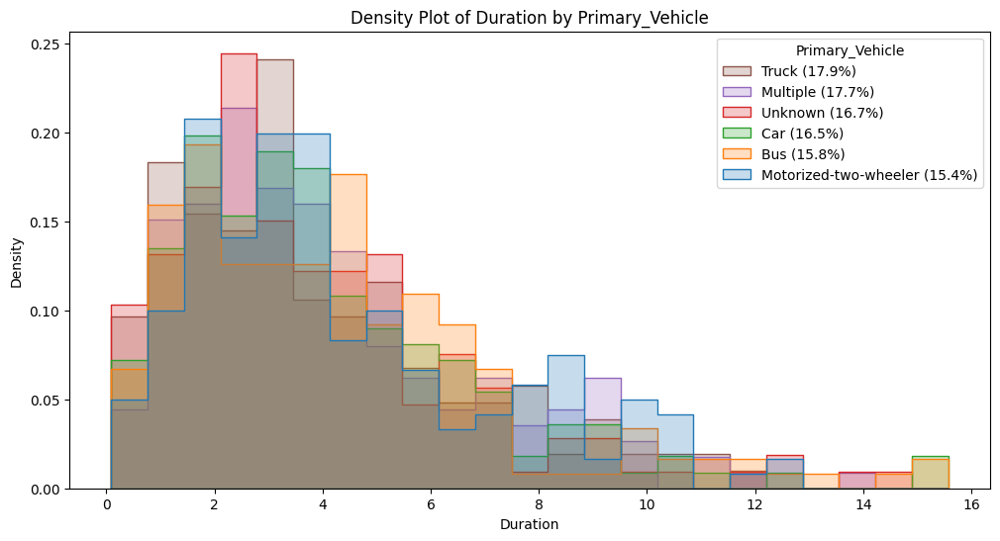

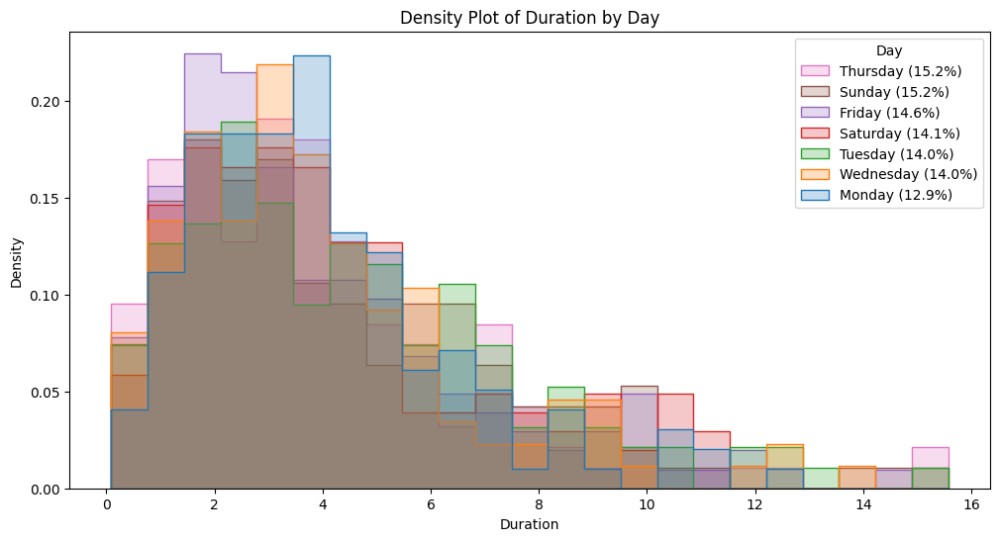

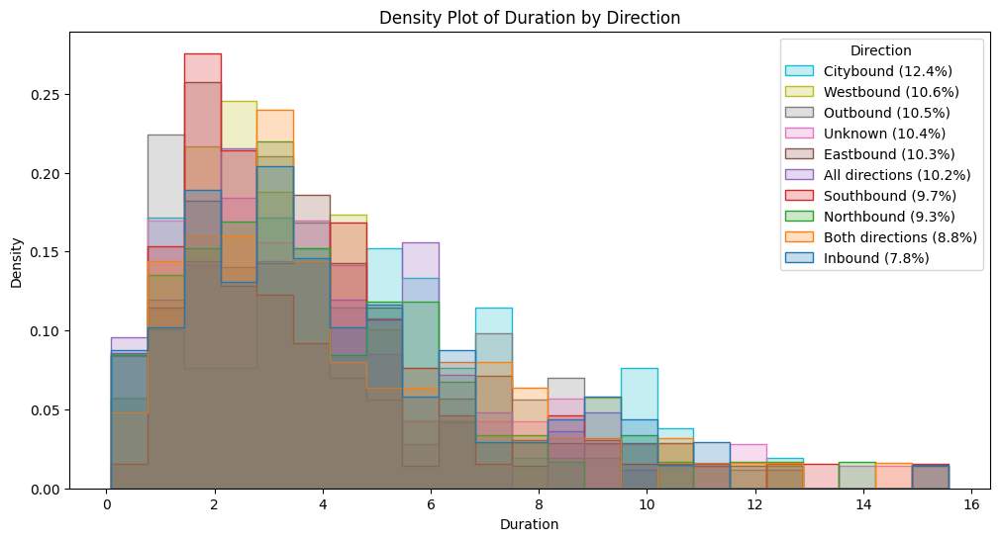

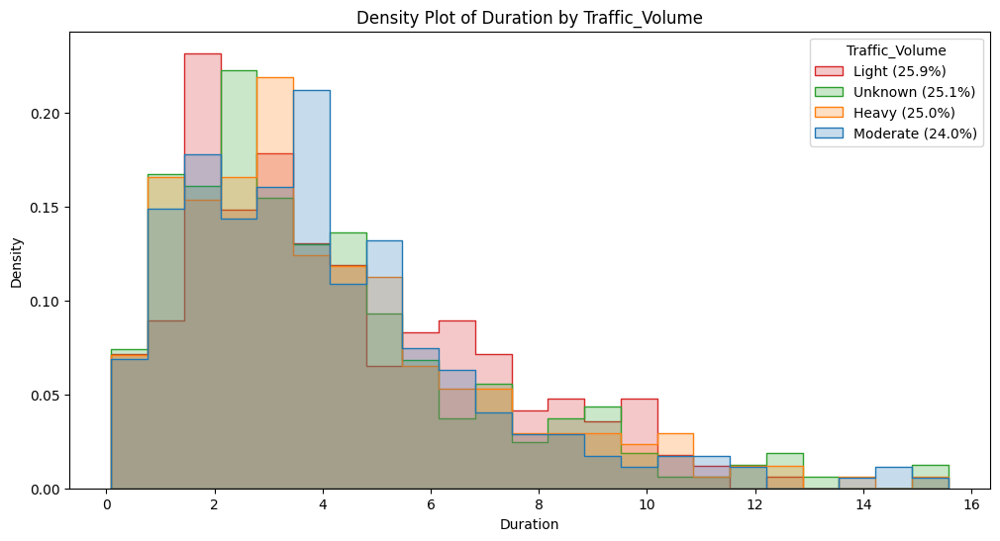

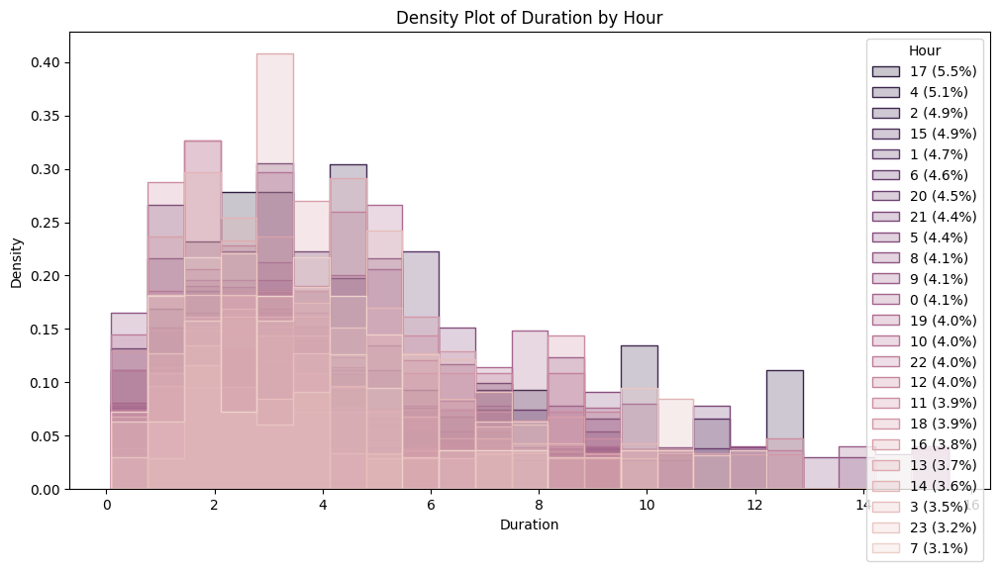

In [15]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import kruskal, mannwhitneyu

# Load your DataFrame here
# df = pd.read_csv('path_to_your_data.csv')

# Mock-up data for demonstration purposes
np.random.seed(42)  # For reproducible random results
# data = {
#     'duration': np.random.gamma(2, 2, 1000),
#     'Main_Category': np.random.choice(['Breakdown', 'Crash', 'Others'], 1000),
#     'Primary_Vehicle': np.random.choice(['Car', 'Bus', 'Truck', 'Motorized-two-wheeler', 'Unknown', 'Multiple'], 1000),
#     'Day': np.random.choice(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], 1000),
#     'Direction': np.random.choice(['Eastbound', 'Westbound', 'Southbound', 'Northbound', 'Inbound', 'Outbound', 'Citybound', 'Both directions', 'All directions', 'Unknown'], 1000),
#     'Traffic_Volume': np.random.choice(['Heavy', 'Light', 'Moderate', 'Unknown'], 1000),
#     'Hour': np.random.choice(range(24), 1000)
# }
# df = pd.DataFrame(data)

# List of categorical variables
categorical_vars = ['Main_Category', 'Primary_Vehicle', 'Day', 'Direction', 'Traffic_Volume', 'Hour']

# Visualization using boxplots
for var in categorical_vars:
    plt.figure(figsize=(12, 6))
    # Create a boxplot
    sns.boxplot(x=var, y='duration', data=df)
    plt.title(f'Distribution of Duration by {var}')
    plt.xticks(rotation=45)  # Rotate category labels for better readability if necessary
    plt.show()

    # Statistical Test
    # Kruskal-Wallis Test for variables with more than two unique values
    if df[var].nunique() > 2:
        groups = [group["duration"].values for name, group in df.groupby(var) if len(group["duration"]) > 1]
        if len(groups) > 1:
            stat, p_value = kruskal(*groups)
            print(f'Kruskal-Wallis Test for {var} - p-value: {p_value}')
    else:  # Mann-Whitney U Test for binary categories
        groups = [group["duration"].values for name, group in df.groupby(var) if len(group["duration"]) > 1]
        if len(groups) == 2:
            stat, p_value = mannwhitneyu(*groups)
            print(f'Mann-Whitney U Test for {var} - p-value: {p_value}') 

# Additional Density Plots
for var in categorical_vars:
    plt.figure(figsize=(12, 6))
    hist_plot = sns.histplot(data=df, x='duration', hue=var, element='step', stat='density', common_norm=False)
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')
    
    # Get the total counts for each category to calculate the percentage
    total_counts = df[var].value_counts()
    labels_with_percents = [f"{label} ({perc:.1f}%)" for label, perc in ((total_counts / total_counts.sum()) * 100).items()]
    
    # Set legend with new labels
    plt.legend(title=var, labels=labels_with_percents)
    plt.show()

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import kruskal, mannwhitneyu

# Example DataFrame loading (replace with your actual data loading method)
# df = pd.read_csv('path_to_file.csv')

# List of categorical variables based on the provided metadata
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Day', # Assuming 'Incident_Type' corresponds to 'Day' here for example purposes
    'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Visualization of 'duration' across different categories using seaborn
for var in categorical_vars:
    plt.figure(figsize=(12, 6))  # Slightly larger figure for better visibility
    sns.boxplot(x=var, y='duration', data=df)
    plt.title(f'Distribution of Duration by {var}')
    plt.xticks(rotation=45)  # Rotate category labels for better readability
    plt.show()

    # Kruskal-Wallis Test assumes more than two groups and responses are continuous or ordinal
    if df[var].nunique() > 2:
        groups = [group["duration"].values for name, group in df.groupby(var) if len(group["duration"]) > 1]
        if len(groups) > 1:  # Ensure there are at least two groups with data
            stat, p_value = kruskal(*groups)
            print(f'Kruskal-Wallis Test for {var} - p-value: {p_value}')
    else:
        # For binary categories, utilize the Mann-Whitney U Test
        groups = [group["duration"].values for name, group in df.groupby(var) if len(group["duration"]) > 1]
        if len(groups) == 2:  # Mann-Whitney test requires exactly two groups
            stat, p_value = mannwhitneyu(*groups)
            print(f'Mann-Whitney U Test for {var} - p-value: {p_value}')

# Additional plotting: histogram of 'duration' by different categories (optional detail)
for var in categorical_vars:
    plt.figure(figsize=(12, 6))
    sns.histplot(data=df, x='duration', hue=var, element='step', stat='density', common_norm=False)
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')
    plt.legend(title=var, labels=[f"{k}: {v*100:.1f}%" for k, v in df[var].value_counts(normalize=True).items()])
    plt.show()

In [7]:
df

,Main_Category,Longitude,Latitude,Day,duration,Primary_Vehicle,Secondary_Vehicle,Is_Major_Incident,Advice_A,Advice_B,...,Motorway crew,Emergency services,Transport for NSW,Tow truck,Heavy vehicle tow truck,Incident_Type,Num_Vehicles_Involved,Month,Hour,distance_to_CBD
0,1,151.058,-33.9431,5,39.319950,1,2,0,10,0,...,0,1,0,0,0,0,2,8,19,15.781064
1,0,151.159,-33.8096,6,12.029000,1,9,0,10,134,...,0,0,0,0,0,1,1,8,0,8.323913
2,1,150.875,-33.7344,6,16.956667,1,9,0,26,134,...,0,1,0,0,0,0,1,8,1,34.354983
3,1,150.973,-33.8172,6,42.804117,5,2,0,10,0,...,0,1,1,0,0,0,1,8,1,22.500677
4,1,150.981,-33.7919,6,40.840000,3,4,0,10,134,...,0,0,0,0,0,0,3,8,1,22.753003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85592,0,151.070,-33.8579,1,0.782333,5,8,0,18,37,...,0,0,0,0,0,1,1,7,1,12.758398
85593,0,151.159,-33.6148,1,0.912617,1,8,0,18,37,...,0,0,0,0,0,1,1,7,4,29.004167
85597,0,151.211,-33.8435,4,0.908167,1,8,0,10,0,...,0,0,0,1,0,1,1,7,4,3.323727
85598,0,151.192,-33.5559,0,0.826567,1,8,0,10,134,...,0,0,0,0,0,1,1,7,8,35.225187


In [10]:
plt.hist(df['duration'].values,bins=60)
print()

KeyError: 'duration'

In [3]:
pd.set_option('display.max_rows', 500)

In [3]:
print(df.head(2).T)

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import kruskal

categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Visualization of 'duration' across different categories
for var in categorical_vars:
    plt.figure(figsize=(7, 3))
    sns.boxplot(x=var, y='duration', data=df)
    plt.title(f'Distribution of Duration by {var}')
    plt.show()

    # Perform Kruskal-Wallis Test if the variable has more than 2 unique categories
    if df[var].nunique() > 2:
        groups = [group["duration"].values for name, group in df.groupby(var) if group["duration"].size > 0]
        stat, p_value = kruskal(*groups)
        print(f'Kruskal-Wallis Test for {var} - p-value: {p_value}')
    else:
        # For binary categories, a simpler test like Mann-Whitney can be used
        groups = [group["duration"].values for name, group in df.groupby(var) if group["duration"].size > 0]

In [12]:
import pandas as pd
import numpy as np
from lifelines import CoxPHFitter
from lifelines.plotting import plot_lifetimes
import matplotlib.pyplot as plt

# Preparing data (selecting a few categorical variables as covariates and the duration)
categorical_vars = ['Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 'Closure_Type', 
                    'Direction', 'Traffic_Volume', 'Incident_Type', 'Num_Vehicles_Involved', 
                    'Month', 'Hour']

# Convert categorical variables to 'category' dtype for lifelines
for var in categorical_vars:
    df[var] = df[var].astype('category')

# The Cox Proportional Hazards model
cph = CoxPHFitter()

# Fit the model (include only a few variables for simplicity or based on domain knowledge)
selected_vars = ['duration', '] + categorical_vars
df_model = df[selected_vars].dropna()  # Ensure no NaN values which might cause errors

cph.fit(df_model, duration_col='duration', event_col='event')
cph.print_summary()

# Plotting the survival function for the first few individuals
plt.figure(figsize=(10, 6))
plot_lifetimes(df_model['duration'].head(50), event_observed=df_model['event'].head(50))
plt.title('Survival of Incidents: Duration and Event Observation')
plt.show()

# To get the proportional hazard assumption test results
cph.check_assumptions(df_model, p_value_threshold=0.05)

# To visualize the impact of a covariate
cph.plot_partial_effects_on_outcome(covariates='Main_Category', values=[0, 1, 2], cmap='coolwarm')


KeyError: 'event'

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wasserstein_distance, kruskal, mannwhitneyu

# Assuming 'df' is your DataFrame and 'duration' is the continuous variable of interest
# List of categorical variables identified previously
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Calculate and print Wasserstein distances
for var in categorical_vars:
    unique_categories = df[var].unique()
    print(f'\nWasserstein distances for variable: {var}')
    for i in range(len(unique_categories)):
        for j in range(i+1, len(unique_categories)):
            dist = wasserstein_distance(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )
            print(f"Distance between {unique_categories[i]} and {unique_categories[j]}: {dist}")

    # Statistical Test
    # Perform Kruskal-Wallis Test if the variable has more than 2 unique categories
    if df[var].nunique() > 2:
        groups = [group["duration"].values for name, group in df.groupby(var) if group["duration"].size > 0]
        stat, p_value = kruskal(*groups)
        print(f'Kruskal-Wallis Test for {var} - p-value: {p_value}')
    else:
        # For binary categories, a simpler test like Mann-Whitney can be used
        groups = [group["duration"].values for name, group in df.groupby(var) if group["duration"].size > 0]
        if len(groups) > 1:
            stat, p_value = mannwhitneyu(*groups)
            print(f'Mann-Whitney Test for {var} - p-value: {p_value}')

# Visualization of distributions (optional visual check)
for var in categorical_vars:
    plt.figure(figsize=(10, 6))
    sns.histplot(df, x='duration', hue=var, element='step', stat='density', common_norm=False)
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')
    plt.legend(title=var)
    plt.show()


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wasserstein_distance, kruskal, mannwhitneyu

# Assuming 'df' is your DataFrame and 'duration' is the continuous variable of interest
# List of categorical variables identified previously
categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

# Initialize dictionary for storing Wasserstein distances
wasserstein_results = {}

for var in categorical_vars:
    plt.figure(figsize=(10, 6))
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')

    for category in df[var].unique():
        sns.distplot(df[df[var] == category]['duration'], hist = False, kde = True, 
                     kde_kws = {'linewidth': 3}, 
                     label = category)

    plt.legend(title = var, loc='upper right')
    plt.show()

# Construction of Heat Matrix for Wasserstein distances
wasserstein_df = pd.DataFrame(index = categorical_vars, columns = categorical_vars)

for var1 in categorical_vars:
    for var2 in categorical_vars:
        unique_categories_1 = df[var1].unique()
        unique_categories_2 = df[var2].unique()
        
        dist_list = []
        for cat1 in range(len(unique_categories_1)):
            for cat2 in range(cat1+1, len(unique_categories_2)):
                dist = wasserstein_distance(
                    df[df[var1] == unique_categories_1[cat1]]['duration'],
                    df[df[var2] == unique_categories_2[cat2]]['duration']
                )
    
                dist_list.append(dist)

        wasserstein_df[var1][var2] = np.mean(dist_list)

plt.figure(figsize=(10,8))
cmap = sns.cm.rocket_r  ## For reverse colormap
sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap=cmap)
plt.title('Heatmap of Average Wasserstein distances')
plt.show()

# Visualization of distributions
for var in categorical_vars:
    plt.figure(figsize=(10, 6))
    sns_hist = sns.histplot(data=df, x='duration', hue=var, element='step', stat='density', common_norm=False)
    sns_hist.set_title(f'Density Plot of Duration by {var}')
    sns_hist.set_xlabel('Duration')
    sns_hist.set_ylabel('Density')
    plt.legend(title=var, labels=[f"{k} ({np.round(v * 100, 2)}%)" for k, v in df[var].value_counts(normalize=True).items()])
    plt.show()

# Scatter plot for visualizing Wasserstein distances
for var in wasserstein_results:
    plt.figure(figsize=(10, 6))
    for pair, dist in wasserstein_results[var].items():
        plt.scatter(pair[0], pair[1], s=dist * 200, alpha=0.5)  # Adjust size multiplier as necessary
    plt.xlabel('Category')
    plt.ylabel('Category')
    plt.title(f'Wasserstein distances for {var}')
    plt.grid(True)
    plt.show()

In [17]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wasserstein_distance

categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

for var in categorical_vars:
    unique_categories = df[var].unique()
    num_categories = len(unique_categories)
    wasserstein_df = pd.DataFrame(index = unique_categories, columns = unique_categories)

    for i in range(num_categories):
        for j in range(i+1, num_categories):
            dist = wasserstein_distance(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )
    
            wasserstein_df.loc[unique_categories[i], unique_categories[j]] = dist
            wasserstein_df.loc[unique_categories[j], unique_categories[i]] = dist

    plt.figure(figsize=(10, 8))
    sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r")
    plt.title(f'Heatmap of Average Wasserstein distances for {var}')
    plt.savefig(f'Heatmap_{var}.pdf')
    plt.close()

# Density Plots
for var in categorical_vars:
    plt.figure(figsize=(10, 6))
    for category in df[var].unique():
        sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3, 
                    label = category)
        
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')
    plt.legend(title = var)
    plt.savefig(f'DensityPlot_{var}.pdf')
    plt.close()

C:\Users\A\AppData\Local\Temp\ipykernel_26548\1848450398.py:38: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,
C:\Users\A\AppData\Local\Temp\ipykernel_26548\1848450398.py:38: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,


In [18]:
import pandas as pd
import numpy as np
from scipy.stats import kruskal
import matplotlib.pyplot as plt
import seaborn as sns

categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

for var in categorical_vars:
    unique_categories = df[var].unique()
    num_categories = len(unique_categories)
    wasserstein_df = pd.DataFrame(index=unique_categories, columns=unique_categories)
    kruskal_df = pd.DataFrame(index=unique_categories, columns=unique_categories)

    for i in range(num_categories):
        for j in range(i+1, num_categories):
            dist = wasserstein_distance(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )
            
            h_val, p_val = kruskal(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )

            wasserstein_df.loc[unique_categories[i], unique_categories[j]] = dist
            wasserstein_df.loc[unique_categories[j], unique_categories[i]] = dist
            
            kruskal_df.loc[unique_categories[i], unique_categories[j]] = p_val
            kruskal_df.loc[unique_categories[j], unique_categories[i]] = p_val

    fig, axs = plt.subplots(2, figsize=(10, 18))

    sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=axs[0])
    axs[0].set_title(f'Heatmap of Average Wasserstein distances for {var}')
    
    sns.heatmap(kruskal_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=axs[1])
    axs[1].set_title(f'Heatmap of Kruskal-Wallis p-values for {var}')
    

    plt.tight_layout()
    plt.savefig(f'Heatmaps_{var}.png', dpi=300)
    
    plt.close()

for var in categorical_vars:
    plt.figure(figsize=(10, 6))

    for category in df[var].unique():
        sns.kdeplot(df[df[var] == category]['duration'], lw = 3, label = category)
        
    plt.title(f'Density Plot of Duration by {var}')
    plt.xlabel('Duration')
    plt.ylabel('Density')
    plt.legend(title=var)
    plt.savefig(f'DensityPlot_{var}.png', dpi=300)
    
    plt.close()

C:\Users\A\AppData\Local\Temp\ipykernel_26548\516424248.py:55: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], lw = 3, label = category)
C:\Users\A\AppData\Local\Temp\ipykernel_26548\516424248.py:55: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], lw = 3, label = category)


In [30]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wasserstein_distance, kruskal
import matplotlib

# setting global parameters for all seaborn plots
sns.set(style="whitegrid")
matplotlib.rcParams['figure.dpi'] = 300

categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

for var in categorical_vars:
    unique_categories = sorted(df[var].unique())
    num_categories = len(unique_categories)
    wasserstein_df = pd.DataFrame(index = unique_categories, columns = unique_categories)
    kruskal_df = pd.DataFrame(index = unique_categories, columns = unique_categories)

    for i in range(num_categories):
        for j in range(i+1, num_categories):
            dist = wasserstein_distance(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )

            wasserstein_df.loc[unique_categories[i], unique_categories[j]] = dist
            wasserstein_df.loc[unique_categories[j], unique_categories[i]] = dist

            _, p_val = kruskal(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )

            kruskal_df.loc[unique_categories[i], unique_categories[j]] = p_val
            kruskal_df.loc[unique_categories[j], unique_categories[i]] = p_val

#     fig, ax = plt.subplots(figsize=(10, 8))
#     if num_categories>12:
#         sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".0f", cmap="rocket_r", ax=ax)
#     else:
#         sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
#     ax.set_title(f'Heatmap of Average Wasserstein distances for {var}')
#     fig.savefig(f'Heatmap_{var}.pdf')
#     plt.close(fig)
    
    
    max_wass_diff = np.max(wasserstein_df.astype(float).max())
    
    fig, ax = plt.subplots(figsize=(10, 8))
    if num_categories>12:
        hm = sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".0f", cmap="rocket_r", ax=ax)
    else:
        hm = sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
        
    hm.set_title(f'Heatmap of Average Wasserstein distances for {var} \n(Max Difference = {max_wass_diff})')
    fig.savefig(f'Heatmap_{var}.pdf')
    plt.close(fig)

    fig, ax = plt.subplots(figsize=(10, 8))
    sns.heatmap(kruskal_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
    ax.set_title(f'Heatmap of Kruskal-Wallis p-values for {var}')
    fig.savefig(f'Heatmap_Kruskal_{var}.pdf')
    plt.close(fig)

# Density Plots
for var in categorical_vars:
    fig, ax = plt.subplots(figsize=(10, 6))
    for category in sorted(df[var].unique()):
        sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3, 
                    label = category, ax=ax)
        
    ax.set_title(f'Density Plot of Duration by {var}')
    ax.set_xlabel('Duration')
    ax.set_ylabel('Density')
    legend = ax.legend(title = var)
    legend.get_title().set_fontsize('9') # for legend title
    plt.setp(legend.get_texts(), fontsize='7') # for legend text
    fig.savefig(f'DensityPlot_{var}.pdf')
    plt.close(fig)

C:\Users\A\AppData\Local\Temp\ipykernel_26548\1398603882.py:74: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,
C:\Users\A\AppData\Local\Temp\ipykernel_26548\1398603882.py:74: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,


In [34]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wasserstein_distance, kruskal
import matplotlib

# setting global parameters for all seaborn plots
sns.set(style="whitegrid")
matplotlib.rcParams['figure.dpi'] = 300

categorical_vars = [
    'Main_Category', 'Primary_Vehicle', 'Secondary_Vehicle', 
    'Is_Major_Incident', 'Closure_Type', 'Direction', 'Traffic_Volume',
    'Incident_Type', 'Num_Vehicles_Involved', 'Month', 'Hour'
]

for var in categorical_vars:
    unique_categories = sorted(df[var].unique())
    num_categories = len(unique_categories)
    wasserstein_df = pd.DataFrame(index = unique_categories, columns = unique_categories)
    kruskal_df = pd.DataFrame(index = unique_categories, columns = unique_categories)

    for i in range(num_categories):
        for j in range(i+1, num_categories):
            dist = wasserstein_distance(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )

            wasserstein_df.loc[unique_categories[i], unique_categories[j]] = dist
            wasserstein_df.loc[unique_categories[j], unique_categories[i]] = dist

            _, p_val = kruskal(
                df[df[var] == unique_categories[i]]['duration'],
                df[df[var] == unique_categories[j]]['duration']
            )

            kruskal_df.loc[unique_categories[i], unique_categories[j]] = p_val
            kruskal_df.loc[unique_categories[j], unique_categories[i]] = p_val

#     fig, ax = plt.subplots(figsize=(10, 8))
#     if num_categories>12:
#         sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".0f", cmap="rocket_r", ax=ax)
#     else:
#         sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
#     ax.set_title(f'Heatmap of Average Wasserstein distances for {var}')
#     fig.savefig(f'Heatmap_{var}.pdf')
#     plt.close(fig)
    
    
    max_wass_diff = np.max(wasserstein_df.astype(float).max())
    
    fig, ax = plt.subplots(figsize=(10, 8))
    if num_categories>12:
        hm = sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".0f", cmap="rocket_r", ax=ax)
    else:
        hm = sns.heatmap(wasserstein_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
        
    hm.set_title(f'Heatmap of Average Wasserstein distances for {var} \n(Max Difference = {np.round(max_wass_diff,2)})')
    fig.savefig(f'Heatmap_{var}.png')
    plt.close(fig)

    fig, ax = plt.subplots(figsize=(10, 8))
    
    if num_categories>12:
        sns.heatmap(kruskal_df.astype(float), annot=True, fmt=".1f", cmap="rocket_r", ax=ax)
    else:
        sns.heatmap(kruskal_df.astype(float), annot=True, fmt=".2f", cmap="rocket_r", ax=ax)
        
    ax.set_title(f'Heatmap of Kruskal-Wallis p-values for {var}')
    fig.savefig(f'Heatmap_Kruskal_{var}.png')
    plt.close(fig)

# Density Plots
for var in categorical_vars:
    fig, ax = plt.subplots(figsize=(10, 6))
    for category in sorted(df[var].unique()):
        sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3, 
                    label = category, ax=ax)
        
    ax.set_title(f'Density Plot of Duration by {var}')
    ax.set_xlabel('Duration')
    ax.set_ylabel('Density')
    legend = ax.legend(title = var)
    legend.get_title().set_fontsize('9') # for legend title
    plt.setp(legend.get_texts(), fontsize='7') # for legend text
    fig.savefig(f'DensityPlot_{var}.png')
    plt.close(fig)

C:\Users\A\AppData\Local\Temp\ipykernel_26548\1862552363.py:79: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,
C:\Users\A\AppData\Local\Temp\ipykernel_26548\1862552363.py:79: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df[df[var] == category]['duration'], linewidth = 3,


In [21]:
import pandas as pd
from lifelines import KaplanMeierFitter

# Assuming df is your DataFrame and duration is your duration variable
kmf = KaplanMeierFitter()

for var in categorical_vars:
    fig, ax = plt.subplots(figsize=(10,6))

    for category in df[var].unique():
        ix = df[var] == category
        kmf.fit(df.loc[ix, 'duration'], label=str(category))
        kmf.plot_survival_function(ax=ax)

    plt.title(f'Survival Analysis by {var}')
    plt.savefig(f'SurvivalPlot_{var}.pdf')
    plt.close()

In [24]:
from lifelines import CoxPHFitter

# Initiating the Cox Proportional Hazard Model
cph = CoxPHFitter()

# Fit the data to train the model
cph.fit(df, 'duration', event_col=categorical_vars[0])

# Have a look at the summary of the model
cph.print_summary()

# Predict the Hazard for given values
predictions = cph.predict_partial_hazard(df)

# Predict the Survival function for given values
survival_predictions = cph.predict_survival_function(df)

C:\Python3\lib\site-packages\lifelines\utils\__init__.py:1185: UserWarning: Attempting to convert an unexpected datatype 'category' to float. Suggestion: 1) use `lifelines.utils.datetimes_to_durations` to do conversions or 2) manually convert to floats/booleans.
  warnings.warn(warning_text, UserWarning)
C:\Python3\lib\site-packages\lifelines\utils\__init__.py:1100: ConvergenceWarning: Column(s) ['20_CoI'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)
C:\Python3\lib\site-packages\lifelines\utils\__init__.py:1120: ConvergenceWarning: Column Incident_Type have very low variance when conditioned on death event present or not. This may harm convergence. This could be a form of 'complete separation'. For example, try the following code:

>>> events = df['Main_Category'].astype(bool)
>>> pri

ConvergenceError: Convergence halted due to matrix inversion problems. Suspicion is high collinearity. Please see the following tips in the lifelines documentation: https://lifelines.readthedocs.io/en/latest/Examples.html#problems-with-convergence-in-the-cox-proportional-hazard-modelMatrix is singular.

In [26]:
# Summary Statistics for all variables
summary_stats = df.describe()

# Correlation matrix of all variables
correlation_matrix = df.corr()

In [27]:
summary_stats

,Longitude,Latitude,Day,duration,Is_Major_Incident,Advice_A,Advice_B,Main_Street,Affected_Lanes,Actual_Number_of_Lanes,...,Motorway Crew,Mechanic,Emergency service(s),Tow Truck,Motorway crew,Emergency services,Transport for NSW,Tow truck,Heavy vehicle tow truck,distance_to_CBD
count,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,...,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000,81142.000000
mean,151.066961,-33.846670,3.060018,39.656250,0.014777,12.340933,69.512694,1605.062742,37.754776,42.684676,...,0.072564,0.025733,0.158525,0.065687,0.036060,0.309605,0.361379,0.026521,0.021308,17.297397
std,0.138387,0.093947,2.122096,37.045840,0.120658,5.679676,49.981615,793.699516,47.408266,47.883278,...,0.259421,0.158338,0.365234,0.247736,0.186441,0.462334,0.480403,0.160681,0.144411,12.214956
min,150.501000,-34.161900,0.000000,0.621450,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.036028
25%,150.991000,-33.912800,1.000000,15.201129,0.000000,10.000000,37.000000,1007.000000,1.000000,2.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.682305
50%,151.088000,-33.856900,3.000000,28.684475,0.000000,10.000000,37.000000,1611.000000,1.000000,3.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.369560
75%,151.183000,-33.791200,5.000000,50.886138,0.000000,18.000000,134.000000,2228.000000,99.000000,99.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,23.398629
max,151.334000,-33.382800,6.000000,251.469600,1.000000,27.000000,135.000000,2937.000000,99.000000,99.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,67.646871


In [28]:
correlation_matrix

,Main_Category,Longitude,Latitude,Day,duration,Primary_Vehicle,Secondary_Vehicle,Is_Major_Incident,Advice_A,Advice_B,...,Motorway crew,Emergency services,Transport for NSW,Tow truck,Heavy vehicle tow truck,Incident_Type,Num_Vehicles_Involved,Month,Hour,distance_to_CBD
Main_Category,1.000000,-0.165326,-0.031652,-0.010820,0.045001,0.022946,-0.760937,0.087482,-0.048621,-0.038618,...,-0.079900,0.309318,-0.088206,-0.021688,-0.111089,0.123268,0.535485,0.009938,0.068183,0.158271
Longitude,-0.165326,1.000000,-0.020993,-0.009647,-0.120086,-0.099241,0.119550,-0.023877,-0.004649,0.014212,...,0.014764,-0.120679,0.012234,0.037424,-0.018006,-0.036086,-0.108512,-0.004790,-0.000943,-0.879551
Latitude,-0.031652,-0.020993,1.000000,-0.005146,0.046020,0.023127,0.047867,-0.002666,0.026615,0.002968,...,-0.021991,-0.005003,0.012109,0.011555,0.028565,0.001207,-0.035925,-0.002232,-0.009966,0.281531
Day,-0.010820,-0.009647,-0.005146,1.000000,-0.007181,0.018864,0.005347,-0.004619,-0.005880,0.002174,...,-0.000736,-0.009845,0.011244,0.002705,0.012074,0.000894,-0.010308,0.001126,-0.029698,0.005091
duration,0.045001,-0.120086,0.046020,-0.007181,1.000000,0.176460,0.022452,0.161929,-0.057678,-0.009132,...,-0.017126,0.007767,-0.057861,-0.021593,0.149862,0.021474,-0.030539,0.000075,0.030127,0.145766
Primary_Vehicle,0.022946,-0.099241,0.023127,0.018864,0.176460,1.000000,0.147459,0.034499,0.110709,-0.105162,...,0.000373,-0.064093,0.031637,-0.035535,0.153551,-0.053375,-0.095055,0.011348,-0.060106,0.109163
Secondary_Vehicle,-0.760937,0.119550,0.047867,0.005347,0.022452,0.147459,1.000000,-0.054848,0.063978,0.023124,...,0.076836,-0.276127,0.047913,0.022508,0.092633,-0.119109,-0.625681,-0.008438,-0.027616,-0.096500
Is_Major_Incident,0.087482,-0.023877,-0.002666,-0.004619,0.161929,0.034499,-0.054848,1.000000,-0.086030,-0.004886,...,0.005349,-0.031640,-0.046838,-0.007500,-0.001803,-0.000334,0.039760,0.003039,-0.025481,0.030294
Advice_A,-0.048621,-0.004649,0.026615,-0.005880,-0.057678,0.110709,0.063978,-0.086030,1.000000,-0.169210,...,0.023142,0.022542,0.033035,0.018573,0.008212,-0.046119,-0.075644,-0.000930,0.055314,0.016141
Advice_B,-0.038618,0.014212,0.002968,0.002174,-0.009132,-0.105162,0.023124,-0.004886,-0.169210,1.000000,...,0.033174,-0.139026,-0.146620,0.030830,-0.037756,-0.117305,-0.000131,-0.016356,0.035716,-0.012206


In [ ]:
import pandas as pd
from lifelines import KaplanMeierFitter

# Assuming df is your DataFrame and duration is your duration variable
kmf = KaplanMeierFitter()

for var in categorical_vars:
    fig, ax = plt.subplots(figsize=(10,6))

    for category in df[var].unique():
        ix = df[var] == category
        kmf.fit(df.loc[ix, 'duration'], label=str(category))
        kmf.plot_survival_function(ax=ax)

    plt.title(f'Survival Analysis by {var}')
    plt.savefig(f'SurvivalPlot_{var}.pdf')
    plt.close()

In [4]:
!pip install lifelines

     ---------------------------------------- 0.0/349.2 kB ? eta -:--:--
     --------- ----------------------------- 81.9/349.2 kB 4.5 MB/s eta 0:00:01
     ------------------ ------------------- 174.1/349.2 kB 2.6 MB/s eta 0:00:01
     ----------------------------------- -- 327.7/349.2 kB 3.4 MB/s eta 0:00:01
     -------------------------------------- 349.2/349.2 kB 2.7 MB/s eta 0:00:00
     ---------------------------------------- 0.0/49.3 kB ? eta -:--:--
     ---------------------------------------- 49.3/49.3 kB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 0.0/94.2 kB ? eta -:--:--
     ---------------------------------------  92.2/94.2 kB 2.6 MB/s eta 0:00:01
     ---------------------------------------- 94.2/94.2 kB 1.8 MB/s eta 0:00:00
  Created wheel for autograd-gamma: filename=autograd_gamma-0.5.0-py3-none-any.whl size=4048 sha256=7a159481c5ec6909fda77


[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


            coef  se(coef)  coef lower 95%  coef upper 95%  cmp to          z   
mu_     1.985125  0.058988        1.869510        2.100741     0.0  33.652782  \
sigma_  0.561165  0.044059        0.474811        0.647520     1.0  -9.960104   

                    p    -log2(p)  
mu_     2.839023e-248  822.332773  
sigma_   2.278235e-23   75.216429  
            coef  se(coef)  coef lower 95%  coef upper 95%  cmp to          z   
alpha_  7.235752  0.426383        6.400055        8.071448     1.0  14.624749  \
beta_   3.094247  0.281693        2.542138        3.646355     1.0   7.434491   

                   p    -log2(p)  
alpha_  1.952897e-48  158.486933  
beta_   1.049717e-13   43.115065  


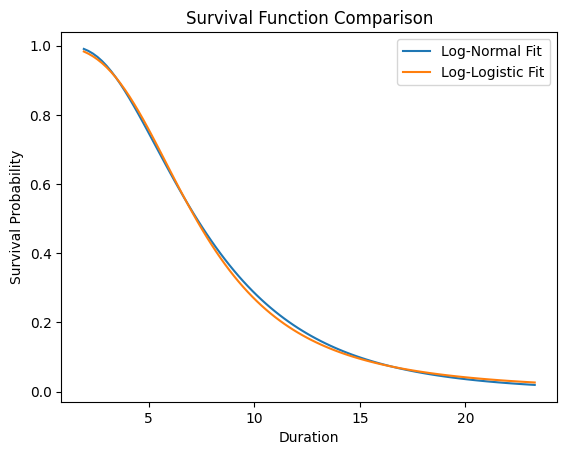

In [5]:
import pandas as pd
from lifelines import LogNormalFitter, LogLogisticFitter
import numpy as np

# Example data
# Replace this with your actual data loading mechanism
data = {
    'duration': np.random.lognormal(mean=2, sigma=0.5, size=100),
    'event_observed': np.random.binomial(1, 0.8, size=100)
}
df = pd.DataFrame(data)

# Fitting a Log-Normal model
log_normal_model = LogNormalFitter()
log_normal_model.fit(durations=df['duration'], event_observed=df['event_observed'], label='Log-Normal Fit')
print(log_normal_model.summary)

# Fitting a Log-Logistic model
log_logistic_model = LogLogisticFitter()
log_logistic_model.fit(durations=df['duration'], event_observed=df['event_observed'], label='Log-Logistic Fit')
print(log_logistic_model.summary)

# Optionally: Plotting the survival function from both models
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
log_normal_model.survival_function_.plot(ax=ax)
log_logistic_model.survival_function_.plot(ax=ax)
ax.set_title('Survival Function Comparison')
ax.set_xlabel('Duration')
ax.set_ylabel('Survival Probability')
plt.legend()
plt.show()


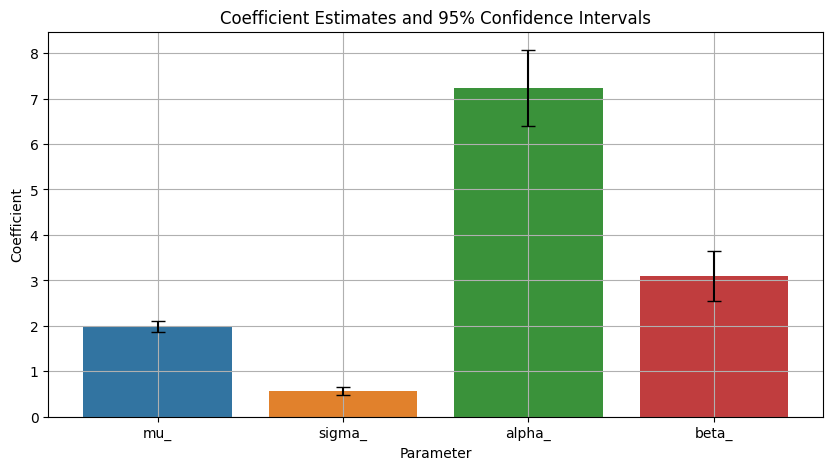

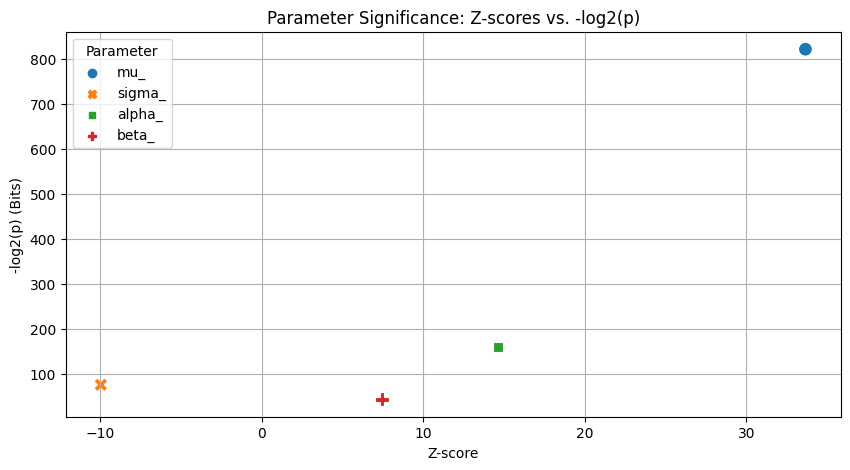

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'results' is a DataFrame that includes the modeling results you've posted
results = pd.DataFrame({
    'Parameter': ['mu_', 'sigma_', 'alpha_', 'beta_'],
    'coef': [1.985125, 0.561165, 7.235752, 3.094247],
    'se(coef)': [0.058988, 0.044059, 0.426383, 0.281693],
    'coef lower 95%': [1.869510, 0.474811, 6.400055, 2.542138],
    'coef upper 95%': [2.100741, 0.647520, 8.071448, 3.646355],
    'z': [33.652782, -9.960104, 14.624749, 7.434491],
    '-log2(p)': [822.332773, 75.216429, 158.486933, 43.115065]
})

# Plotting Coefficient Estimates and Confidence Intervals
plt.figure(figsize=(10, 5))
sns.barplot(x='Parameter', y='coef', data=results)
plt.errorbar(results['Parameter'], results['coef'], 
             yerr=[results['coef'] - results['coef lower 95%'], results['coef upper 95%'] - results['coef']],
             fmt='none', c='black', capsize=5)
plt.title('Coefficient Estimates and 95% Confidence Intervals')
plt.xlabel('Parameter')
plt.ylabel('Coefficient')
plt.grid(True)
plt.show()

# Z-score and P-values plot
plt.figure(figsize=(10, 5))
sns.scatterplot(x='z', y='-log2(p)', data=results, hue='Parameter', style='Parameter', s=100)
plt.title('Parameter Significance: Z-scores vs. -log2(p)')
plt.xlabel('Z-score')
plt.ylabel('-log2(p) (Bits)')
plt.grid(True)
plt.legend(title='Parameter')
plt.show()


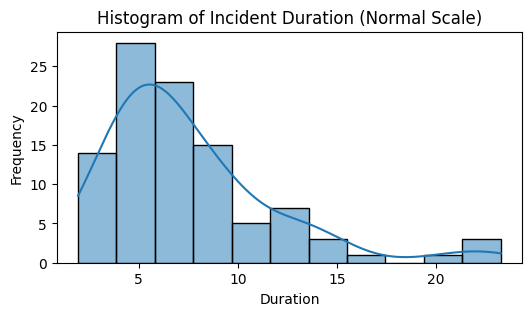

In [15]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.distributions.empirical_distribution import ECDF

# Sample DataFrame
# data = {'duration': np.random.exponential(scale=10, size=1000)}  # Example data, you can replace it with your DataFrame
# df = pd.DataFrame(data)
plt.figure(figsize=(6, 3))
sns.histplot(df['duration'].values, kde=True)
plt.title('Histogram of Incident Duration (Normal Scale)')
plt.xlabel('Duration')
plt.ylabel('Frequency')
plt.show()

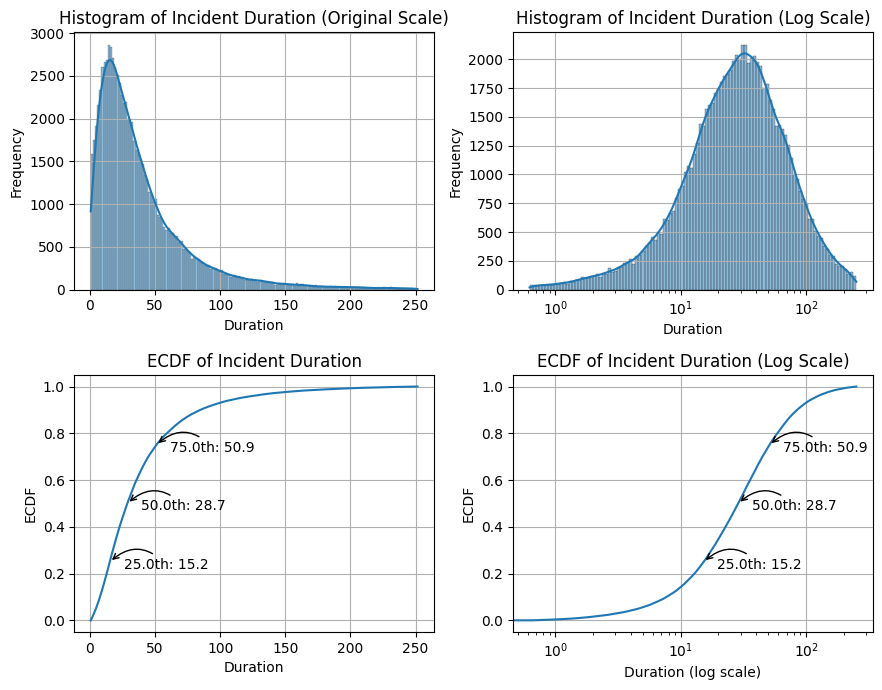

In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.distributions.empirical_distribution import ECDF
from matplotlib.gridspec import GridSpec

from statsmodels.distributions.empirical_distribution import ECDF
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator
filtered_df = df#df[(df['duration'] >= quantile_001) & (df['duration'] <= quantile_099)]

# Create a 2x2 grid layout for subplots
fig = plt.figure(figsize=(9, 7))
gs = GridSpec(2, 2, figure=fig)

# Plot histograms
ax1 = fig.add_subplot(gs[0, 0])
sns.histplot(filtered_df['duration'], kde=True, ax=ax1)
ax1.set_title('Histogram of Incident Duration (Original Scale)')
ax1.set_xlabel('Duration')
ax1.set_ylabel('Frequency')
ax1.grid(True)
# ax1.xaxis.set_major_locator(MultipleLocator(100))

# Log scale histogram
ax2 = fig.add_subplot(gs[0, 1])
sns.histplot(filtered_df['duration'], kde=True, log_scale=True, ax=ax2)
ax2.set_title('Histogram of Incident Duration (Log Scale)')
ax2.set_xlabel('Duration')
ax2.set_ylabel('Frequency')
ax2.grid(True)

# ECDF
# ECDF plot
ax3 = fig.add_subplot(gs[1, 0])
ecdf = ECDF(filtered_df['duration'])
ax3.plot(ecdf.x, ecdf.y, label='ECDF')
ax3.set_title('ECDF of Incident Duration')
ax3.set_xlabel('Duration')
ax3.set_ylabel('ECDF')
ax3.grid(True)

# Compute quantiles
quantiles = filtered_df['duration'].quantile([0.25, 0.5, 0.75])

# Annotate quantiles on the ECDF plot
for q in quantiles.index:
    q_value = quantiles[q]
    ecdf_value = ecdf(q_value)
    ax3.annotate(f'{q*100:.1f}th: {np.round(float(q_value),1)}', xy=(q_value, ecdf_value), xytext=(10,-5), 
                 textcoords='offset points', arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"))

# Log scale ECDF
ax4 = fig.add_subplot(gs[1, 1])
ax4.plot(ecdf.x, ecdf.y)
ax4.set_xscale('log')
ax4.set_title('ECDF of Incident Duration (Log Scale)')
ax4.set_xlabel('Duration (log scale)')
ax4.set_ylabel('ECDF')
ax4.grid(True)

# Annotate quantiles on the log-scale ECDF plot
for q in quantiles.index:
    q_value = quantiles[q]
    ecdf_value = ecdf(q_value)
    ax4.annotate(f'{q*100:.1f}th: {np.round(float(q_value),1)}', xy=(q_value, ecdf_value), xytext=(10,-5), 
                 textcoords='offset points', arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"))

plt.tight_layout()
plt.savefig('incident_duration_plots.pdf')
# plt.show()


In [9]:
import pandas as pd

# Assuming 'filtered_df' is your DataFrame and 'duration' is the column of interest.
# Compute basic statistics
stats = filtered_df['duration'].describe()

# Compute additional quantiles
additional_quantiles = filtered_df['duration'].quantile([0.1, 0.9])
# stats = stats.append(additional_quantiles)

# You may want to include other statistics like variance, skewness, and kurtosis
variance = filtered_df['duration'].var()
skewness = filtered_df['duration'].skew()
kurtosis = filtered_df['duration'].kurt()

# Creating a DataFrame to neatly display all statistics
statistical_summary = pd.DataFrame(stats, columns=['Value'])
statistical_summary.loc['variance'] = variance
statistical_summary.loc['skewness'] = skewness
statistical_summary.loc['kurtosis'] = kurtosis

# Display the summary
print(statistical_summary)


                Value
variance  1372.394233
skewness     2.146505
kurtosis     5.921636


In [10]:
stats

count    81142.000000
mean        39.656250
std         37.045840
min          0.621450
25%         15.201129
50%         28.684475
75%         50.886138
max        251.469600
Name: duration, dtype: float64

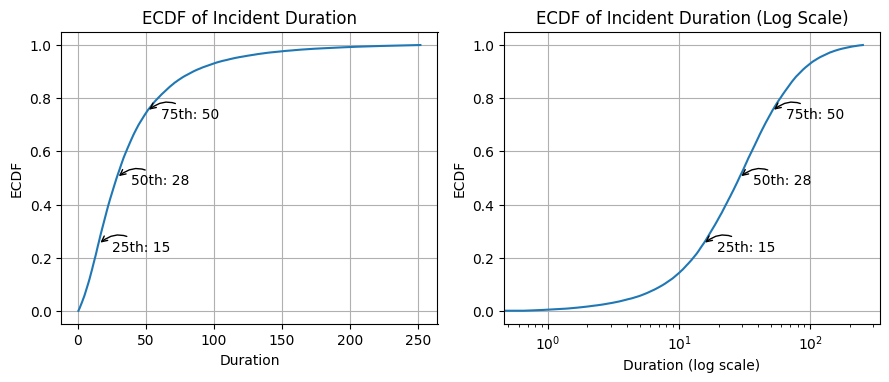

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.distributions.empirical_distribution import ECDF
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

# Assuming 'df' is your DataFrame and you have filtered it as needed.
filtered_df = df  # Example placeholder

# Create a 2x2 grid layout for subplots
fig = plt.figure(figsize=(9, 7))
gs = GridSpec(2, 2, figure=fig)

# ECDF plot
ax3 = fig.add_subplot(gs[1, 0])
ecdf = ECDF(filtered_df['duration'])
ax3.plot(ecdf.x, ecdf.y, label='ECDF')
ax3.set_title('ECDF of Incident Duration')
ax3.set_xlabel('Duration')
ax3.set_ylabel('ECDF')
ax3.grid(True)

# Compute quantiles
quantiles = filtered_df['duration'].quantile([0.25, 0.5, 0.75])

# Annotate quantiles on the ECDF plot
for q in quantiles.index:
    q_value = quantiles[q]
    ecdf_value = ecdf(q_value)
    ax3.annotate(f'{q*100:.0f}th: {int(q_value)}', xy=(q_value, ecdf_value), xytext=(10,-5), 
                 textcoords='offset points', arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"))

# Log scale ECDF
ax4 = fig.add_subplot(gs[1, 1])
ax4.plot(ecdf.x, ecdf.y)
ax4.set_xscale('log')
ax4.set_title('ECDF of Incident Duration (Log Scale)')
ax4.set_xlabel('Duration (log scale)')
ax4.set_ylabel('ECDF')
ax4.grid(True)

# Annotate quantiles on the log-scale ECDF plot
for q in quantiles.index:
    q_value = quantiles[q]
    ecdf_value = ecdf(q_value)
    ax4.annotate(f'{q*100:.0f}th: {int(q_value)}', xy=(q_value, ecdf_value), xytext=(10,-5), 
                 textcoords='offset points', arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=.5"))

plt.tight_layout()
plt.savefig('incident_duration_plots.pdf')
# plt.show()


In [52]:
# import folium

# # Assuming df contains 'Longitude' and 'Latitude' columns
# # Example data creation for demonstration
# # df = pd.DataFrame({
# #     'Longitude': [-122.4194, -122.4195, -122.4196],
# #     'Latitude': [37.7749, 37.7750, 37.7751]
# # })

# # Create a map centered around the average location
# map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
# traffic_map = folium.Map(location=map_center, zoom_start=13)

# # Add traffic incident markers
# for _, row in df.iterrows():
#     folium.Marker(location=[row['Latitude'], row['Longitude']]).add_to(traffic_map)

# # Display the map
# traffic_map.save('traffic_incidents_map.html')
# traffic_map


C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`u

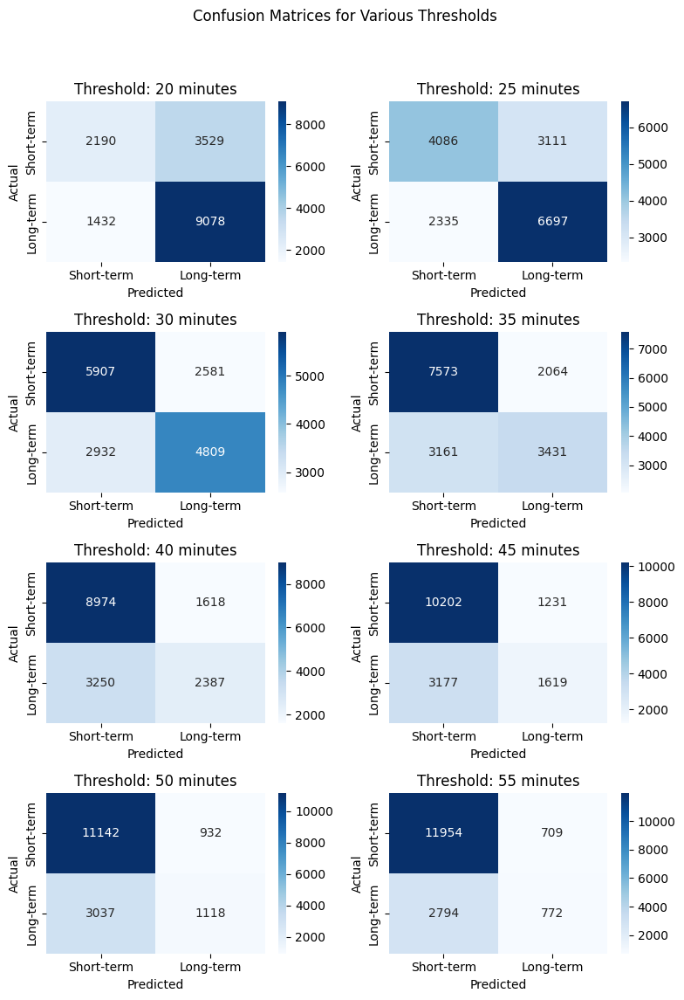

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from xgboost import XGBClassifier
import seaborn as sns

# Assuming df is your DataFrame and it's already defined
# Example DataFrame creation for demonstration purposes
# np.random.seed(42)
# df = pd.DataFrame(np.random.rand(100, 4), columns=['Feature1', 'Feature2', 'Feature3', 'Feature4'])
# df['duration'] = np.random.rand(100) * 100  # Synthetic duration values


X = df.drop(['duration'], axis=1)

# Thresholds for binary split
thresholds = range(20, 60, 5)

# Initialize subplot
n_rows = len(thresholds) // 2 + len(thresholds) % 2
fig, axs = plt.subplots(n_rows, 2, figsize=(8, n_rows * 3))
fig.suptitle('Confusion Matrices for Various Thresholds')

for i, threshold in enumerate(thresholds):
    # Convert 'duration' into a binary classification target based on current threshold
    y = (df['duration'] > threshold).astype(int)
    
    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Train the XGBoost Classifier
    model = XGBClassifier(use_label_encoder=False, eval_metric='rmse')
    model.fit(X_train, y_train)
    
    # Predictions
    y_pred = model.predict(X_test)
    
    # Generate and plot the confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    ax = axs.flatten()[i]
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax,
                xticklabels=['Short-term', 'Long-term'],
                yticklabels=['Short-term', 'Long-term'])
#                 xticklabels=['Predicted as Short-term', 'Predicted as Long-term'],
#                 yticklabels=['Actual Short-term', 'Actual Long-term'])
    ax.set_title(f'Threshold: {threshold} minutes')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust the rect so the title does not overlap with subplots
plt.savefig('multiple_confusion_matrices.pdf')
plt.show()


Script started...


`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecate

Performance plot saved as 'performance_by_threshold_cv_metrics.pdf'.


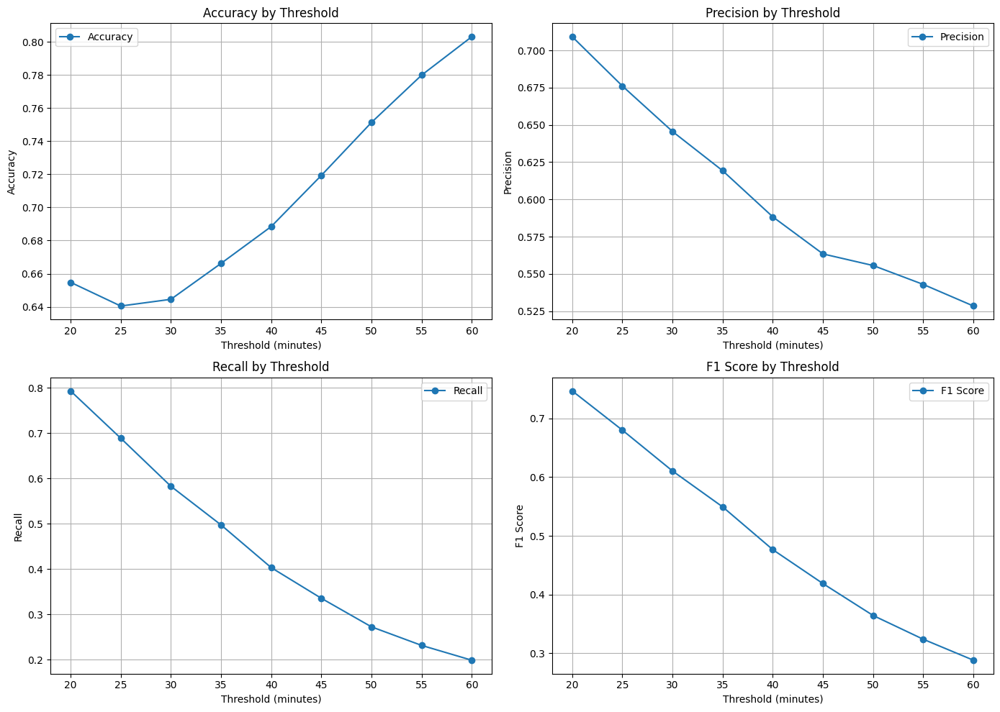

Script completed successfully.


In [50]:
from sklearn.model_selection import cross_validate
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from xgboost import XGBClassifier
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def train_and_evaluate_for_thresholds_cv(X, y_values, thresholds, n_splits=5):
    performances = []
    for threshold in thresholds:
        y = (y_values > threshold).astype(int)
        model = XGBClassifier(use_label_encoder=False, eval_metric='logloss')

        scoring = {'accuracy': 'accuracy',
                   'precision': 'precision',
                   'recall': 'recall',
                   'f1': 'f1'}
        
        # Using cross_validate to compute scores for each fold
        scores = cross_validate(model, X, y, cv=n_splits, scoring=scoring)
        
        # Calculating average scores
        avg_accuracy = np.mean(scores['test_accuracy'])
        avg_precision = np.mean(scores['test_precision'])
        avg_recall = np.mean(scores['test_recall'])
        avg_f1 = np.mean(scores['test_f1'])
        
        performances.append((threshold, avg_accuracy, avg_precision, avg_recall, avg_f1))
    
    return pd.DataFrame(performances, columns=['Threshold', 'Accuracy', 'Precision', 'Recall', 'F1 Score'])

def plot_performance(perf_df):
    fig, axs = plt.subplots(2, 2, figsize=(14, 10))
    metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
    
    for ax, metric in zip(axs.flatten(), metrics):
        ax.plot(perf_df['Threshold'], perf_df[metric], marker='o', label=metric)
        ax.set_title(f'{metric} by Threshold')
        ax.set_xlabel('Threshold (minutes)')
        ax.set_ylabel(metric)
        ax.grid(True)
        ax.legend()
    
    plt.tight_layout()
    plt.savefig('performance_by_threshold_cv_metrics.pdf')
    print("Performance plot saved as 'performance_by_threshold_cv_metrics.pdf'.")
    plt.show()

def main():
    print("Script started...")
    # Assuming df is already defined
    X = df.drop(['duration'], axis=1)
    y_values = df['duration']

    thresholds = range(20, 65, 5)
    perf_df = train_and_evaluate_for_thresholds_cv(X, y_values, thresholds)
    plot_performance(perf_df)

    print("Script completed successfully.")

if __name__ == '__main__':
    main()


Script started...


C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`u

Performance plot saved as 'performance_by_threshold.pdf'.


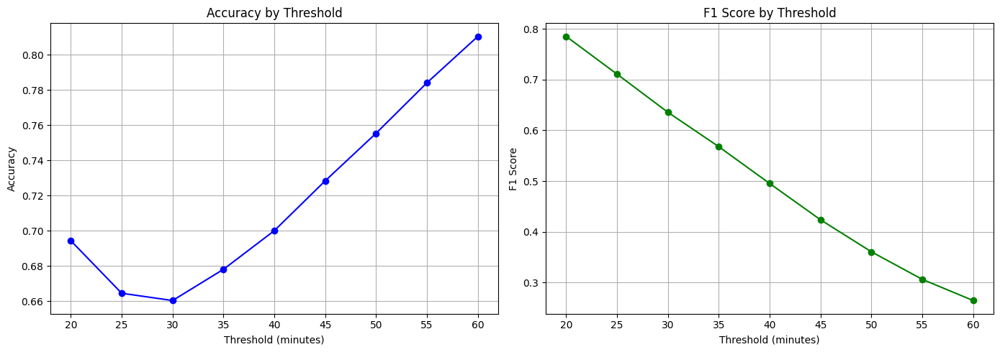

Script completed successfully.


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score
from xgboost import XGBClassifier

def train_and_evaluate_for_thresholds(X, y_values, thresholds):
    performances = []
    for threshold in thresholds:
        y = (y_values > threshold).astype(int)
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        model = XGBClassifier(use_label_encoder=False, eval_metric='logloss')
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        accuracy = accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred, average='binary')
        performances.append((threshold, accuracy, f1))
    
    return pd.DataFrame(performances, columns=['Threshold', 'Accuracy', 'F1 Score'])

def plot_performance(perf_df):
    fig, ax = plt.subplots(1, 2, figsize=(14, 5))

    ax[0].plot(perf_df['Threshold'], perf_df['Accuracy'], marker='o', color='blue', label='Accuracy')
    ax[0].set_title('Accuracy by Threshold')
    ax[0].set_xlabel('Threshold (minutes)')
    ax[0].set_ylabel('Accuracy')
    ax[0].grid(True)
    
    ax[1].plot(perf_df['Threshold'], perf_df['F1 Score'], marker='o', color='green', label='F1 Score')
    ax[1].set_title('F1 Score by Threshold')
    ax[1].set_xlabel('Threshold (minutes)')
    ax[1].set_ylabel('F1 Score')
    ax[1].grid(True)

    plt.tight_layout()
    plt.savefig('performance_by_threshold.pdf')
    print("Performance plot saved as 'performance_by_threshold.pdf'.")
    plt.show()

def main():
    print("Script started...")
    # Assuming df is already defined
    X = df.drop(['duration'], axis=1)
    y_values = df['duration']

    thresholds = range(20, 65, 5)
    perf_df = train_and_evaluate_for_thresholds(X, y_values, thresholds)
    plot_performance(perf_df)

    print("Script completed successfully.")

if __name__ == '__main__':
    main()


Script started...
Starting model training and evaluation...
Training model: XGBoost Classifier


C:\Python3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


Accuracy for XGBoost Classifier: 0.6602994639226076, F1 Score: 0.6356486682968739
Training model: LightGBM Classifier
Accuracy for LightGBM Classifier: 0.6693573233101239, F1 Score: 0.64571504027466
Training model: Random Forest Classifier
Accuracy for Random Forest Classifier: 0.6383018054100684, F1 Score: 0.6145258733911216
Training model: Extra Trees Classifier
Accuracy for Extra Trees Classifier: 0.6254852424671884, F1 Score: 0.5984408033826639
Training model: Decision Tree Classifier
Accuracy for Decision Tree Classifier: 0.580134327438536, F1 Score: 0.5630931007950757
Plotting model performance...
Model performance plot saved as 'model_performance_classification_metrics.pdf'.
Script completed successfully.


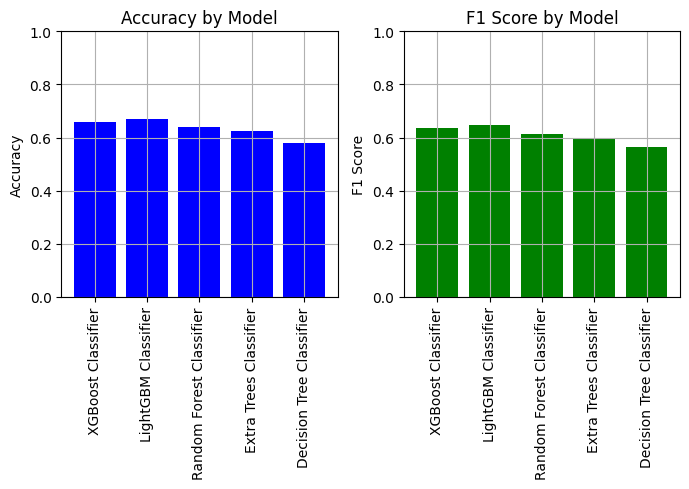

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, f1_score
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

def train_models_and_plot(names, models, X_train, X_test, y_train, y_test):
    print("Starting model training and evaluation...")
#     scaler = StandardScaler()
#     X_train = scaler.fit_transform(X_train)
#     X_test = scaler.transform(X_test)
    
    performances = []
    for name, model in zip(names, models):
        print(f"Training model: {name}")
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred, average='binary')  # Use 'binary' for binary classification
        print(f"Accuracy for {name}: {accuracy}, F1 Score: {f1}")
        performances.append((name, accuracy, f1))
    
    perf_df = pd.DataFrame(performances, columns=['Model', 'Accuracy', 'F1 Score'])
    print("Plotting model performance...")

    # Creating a single figure with two subplots (vertically arranged)
    fig, ax = plt.subplots(1, 2, figsize=(7, 5))
    
    # Plot for Accuracy
    ax[0].bar(perf_df['Model'], perf_df['Accuracy'], color='blue')
    ax[0].set_title('Accuracy by Model')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_ylim([0, 1])
    ax[0].grid(True)  # Enable grid
    for tick in ax[0].get_xticklabels():
        tick.set_rotation(90)  # Rotate model names for better readability
    
    # Plot for F1 Score
    ax[1].bar(perf_df['Model'], perf_df['F1 Score'], color='green')
    ax[1].set_title('F1 Score by Model')
    ax[1].set_ylabel('F1 Score')
    ax[1].set_ylim([0, 1])
    ax[1].grid(True)  # Enable grid
    for tick in ax[1].get_xticklabels():
        tick.set_rotation(90)  # Rotate model names for better readability
    
    plt.tight_layout()  # Adjust layout to not overlap
    plt.savefig('model_performance_classification_metrics.pdf')
    print("Model performance plot saved as 'model_performance_classification_metrics.pdf'.")


def main():
    print("Script started...")
    # Example DataFrame creation
    # Placeholder for actual data loading logic
    
    # Assuming df is already defined
    # Convert 'duration' into a binary classification target
    y = (df['duration'] > 30).astype(int)
    X = df.drop(['duration'], axis=1)

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Model names and instances
    names = ["XGBoost Classifier", "LightGBM Classifier", "Random Forest Classifier", "Extra Trees Classifier", "Decision Tree Classifier"]
    models = [
        XGBClassifier(use_label_encoder=False, eval_metric='rmse'),
        LGBMClassifier(random_state=42),
        RandomForestClassifier(n_jobs=10, random_state=42),
        ExtraTreesClassifier(n_jobs=10, random_state=42),
        DecisionTreeClassifier(random_state=42)
    ]
    
    train_models_and_plot(names, models, X_train, X_test, y_train, y_test)
    
    print("Script completed successfully.")

if __name__ == '__main__':
    main()


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error
from tensorflow import keras
from tensorflow.keras import layers
import ast  # Library for handling literal_eval
from geopy.distance import geodesic


df = pd.read_csv('merged_covid.csv')
# columns = ['maincategory', 'longitude', 'latitude', 'starttime', 'duration', 'subCategoryA', 'attendinggroups', 'closuretype', 'mainstreet']
# df = df[columns]
# df = df[df['maincategory']=='Crash']
df=df.dropna()
# Print the column names to verify
print(df.columns)

quantile_001 = df['duration'].quantile(0.02)
quantile_099 = df['duration'].quantile(0.98)
df = df[(df['duration'] >= quantile_001) & (df['duration'] <= quantile_099) & (df['duration']>3)]

Index(['Main_Category', 'Longitude', 'Latitude', 'Day', 'duration',
       'Primary_Vehicle', 'Secondary_Vehicle', 'Display_Name', 'Advice_A',
       'Advice_B', 'Closure_Type', 'Direction', 'Main_Street',
       'Affected_Lanes', 'Actual_Number_of_Lanes ', 'Suburb', 'Traffic_Volume',
       'SA2_CODE21', 'SA3_CODE21', 'SA3_NAME21', 'SA4_CODE21', 'SA4_NAME21',
       'AREASQKM21', '1_Area', '2_ML', '3_TRL', '4_PRL', '5_SRL', '6_TrRL',
       '7_RRL', '8_LsRL', '9_URL', '10_ToRL', '11_EoR', '12_NoN', '13_NDEs',
       '14_NNC2L', '15_NNC3L', '16_NNC4L', '17_AND', '18_NE', '19_MCI',
       '20_CoI', '21 NBS', '22_CA', '23_EA', '24_HA', '25_IA', '26_OA',
       '27_PA', '28_PrA', '29_RA', '30_TA', '31_WbA', '32_EoLU', '33_TP',
       '34_PD0MV', '35_PD1MV', '36_PD2MV', '37_PD3MV', '38_PD≥4MV', '39_PUE',
       '40_AMI', '41_NPTtWbyPT', '42_NPTtWbyTx', '43_NPTtWbyCD',
       '44_NPTtWbyCP', '45_NPTtWbyO', '46_NPWfH', '47_PWCJH', '48_PBCJH',
       '49_ANP_FH', 'Incident_Type', 'Num_Vehicle

# regression

Script started...
Starting model training and evaluation...
Training model: XGBoost
RMSE for XGBoost: 30.850049173843356
R2 Score for XGBoost: 0.1284244641291049
MAPE for XGBoost: 107.54493911852583%
Training model: LightGBM
RMSE for LightGBM: 30.036361296508975
R2 Score for LightGBM: 0.17379475121042098
MAPE for LightGBM: 108.58301111911348%
Training model: Random Forest
RMSE for Random Forest: 30.937170877284036
R2 Score for Random Forest: 0.12349478871962538
MAPE for Random Forest: 113.09451271503283%
Training model: Extra Trees
RMSE for Extra Trees: 31.88854918898272
R2 Score for Extra Trees: 0.06875740546186293
MAPE for Extra Trees: 113.76109840982325%
Training model: Decision Tree
RMSE for Decision Tree: 43.340999918338596
R2 Score for Decision Tree: -0.7202484045641788
MAPE for Decision Tree: 133.9781495551683%
Plotting model performance...
Model performance plot saved as 'model_performance_with_mape.pdf'.
Plotting top 10 feature importances for XGBoost...
Top 12 feature importa

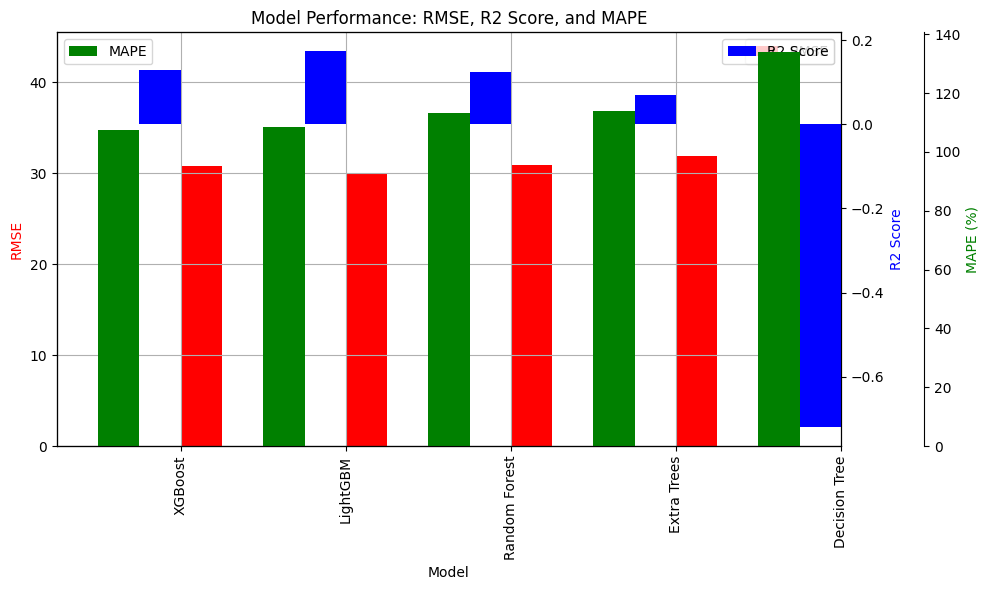

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb
import lightgbm as lgb

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb
import lightgbm as lgb

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score

def train_models_and_plot(names, models, X_train, X_test, y_train, y_test):
    print("Starting model training and evaluation...")
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    
    performance = []
    for name, model in zip(names, models):
        print(f"Training model: {name}")
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        r2 = r2_score(y_test, y_pred)  # Calculate R2 score
        
        # Calculate MAPE
        mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
        
        print(f"RMSE for {name}: {rmse}")
        print(f"R2 Score for {name}: {r2}")
        print(f"MAPE for {name}: {mape}%")
        
        performance.append((name, rmse, r2, mape))
    
    perf_df = pd.DataFrame(performance, columns=['Model', 'RMSE', 'R2 Score', 'MAPE'])
    print("Plotting model performance...")
    fig, ax1 = plt.subplots(figsize=(10, 6))
    
    perf_df.plot(kind='bar', x='Model', y='RMSE', ax=ax1, color='red', position=0, width=0.25)
    ax2 = ax1.twinx()
    perf_df.plot(kind='bar', x='Model', y='R2 Score', ax=ax2, color='blue', position=1, width=0.25)
    ax3 = ax1.twinx()
    ax3.spines['right'].set_position(('outward', 60))
    perf_df.plot(kind='bar', x='Model', y='MAPE', ax=ax3, color='green', position=2, width=0.25)
    
    ax1.set_title('Model Performance: RMSE, R2 Score, and MAPE')
    ax1.set_ylabel('RMSE', color='red')
    ax2.set_ylabel('R2 Score', color='blue')
    ax3.set_ylabel('MAPE (%)', color='green')
    ax1.set_xlabel('Model')
    ax1.grid()
    plt.tight_layout()
    plt.savefig('model_performance_with_mape.pdf')
    print("Model performance plot saved as 'model_performance_with_mape.pdf'.")


def plot_feature_importance(model, X, model_name):
    """
    Plot and save the feature importances of the given model, focusing on the top 10 features.

    Args:
    - model: The trained model object.
    - X (DataFrame): The feature dataset.
    - model_name (str): The name of the model, used for titling and naming the output file.
    """
    print(f"Plotting top 10 feature importances for {model_name}...")
    importances = model.feature_importances_
    indices = np.argsort(importances)[-12:]  # Get indices of top 10 features
    # Adjust the plotting to focus on these top 10 features
    plt.figure(figsize=(5, 4))
    plt.title(f"Top 10 Feature Importances for {model_name}")
    plt.bar(range(12), importances[indices], color="r", align="center")
    # Use the indices to map back to feature names
    plt.xticks(range(12), X.columns[indices], rotation=45, ha="right")
    plt.xlim([-1, 12])  # Adjust xlim to focus on top 10 features
    plt.grid()
    plt.tight_layout()
    filename = f'top_10_feature_importance_{model_name.replace(" ", "_").lower()}.pdf'
    plt.savefig(filename)
    print(f"Top 12 feature importance plot saved as '{filename}'.")
    plt.close()  # Close the plot to free memory and avoid overlap in subsequent plots



def main():
    print("Script started...")
    # Example DataFrame creation
    # Replace this with your actual data loading logic
#     np.random.seed(42)
#     df = pd.DataFrame(np.random.rand(100, 4), columns=['Feature1', 'Feature2', 'Feature3', 'Feature4'])
#     df['duration'] = np.random.rand(100) * 100  # Synthetic target variable

    names = ["XGBoost", "LightGBM", "Random Forest", "Extra Trees", "Decision Tree"]
    models = [
        xgb.XGBRegressor(objective='reg:squarederror'),
        lgb.LGBMRegressor(random_state=42),
        RandomForestRegressor(n_jobs=10, random_state=42),
        ExtraTreesRegressor(n_jobs=10, random_state=42),DecisionTreeRegressor(random_state=42)
    ]

    # Data preparation and model training...
    
    # Plot feature importances for each model

        
    X = df.drop(['duration'], axis=1)
    y = df['duration']  # Apply log1p transformation for regression targets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    train_models_and_plot(names, models, X_train, X_test, y_train, y_test)
    
    for model, name in zip(models, names):
        plot_feature_importance(model, X, name)
    # Example of plotting feature importance for Extra Trees model
#     plot_feature_importance(models[-1], X)  # Extra Trees for feature importance
    
    print("Script completed successfully.")

if __name__ == '__main__':
    main()


Version 0.12.1 of tpot is outdated. Version 0.12.2 was released Friday February 23, 2024.


Optimization Progress:   0%|          | 0/300 [00:00<?, ?pipeline/s]

In [12]:
import tpot

In [9]:
import numpy as np
import pandas as pd
import xgboost as xgb
import shap
import matplotlib.pyplot as plt

# Assuming df is your DataFrame and it's already defined
X = df.drop(['duration'], axis=1)
y = df['duration']  # Log transform the target variable

# Convert the dataset into XGBoost's DMatrix format
dtrain = xgb.DMatrix(X, label=y, feature_names=X.columns)

# Define the parameters for the XGBoost model
params = {
    'objective': 'reg:squaredlogerror',
    'eval_metric': 'rmse',
    'booster': 'gbtree',
    'random_state': 42
}

# Train the model
model = xgb.train(params, dtrain, num_boost_round=100)

# Initialize SHAP explainer and compute SHAP values
explainer = shap.Explainer(model)
shap_values = explainer.shap_values(X)

# Calculate feature importance as the sum of absolute SHAP values
feature_importance = np.sum(np.abs(shap_values), axis=0)
sorted_features_idx = np.argsort(-feature_importance)[:12]

# Prepare for plotting
top_features_names = X.columns[sorted_features_idx]
filtered_shap_values = shap_values[:, sorted_features_idx]

# Plotting the SHAP summary plot for the top 12 features
plt.figure(figsize=(10, 6))
shap.summary_plot(filtered_shap_values, X.iloc[:, sorted_features_idx], feature_names=top_features_names,show=False)
plt.tight_layout()
# Save the plot
plt.savefig('top_12_feature_importance_summary_original_scale_xgboost.pdf', bbox_inches='tight')
plt.close()


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
